# Open and Display an Image with Pillow and MatPlotLib

## Importing Python Modules

References:
-  https://pillow.readthedocs.io/en/stable/handbook/tutorial.html
- https://docs.python.org/3/library/pathlib.html
- https://pillow.readthedocs.io/en/stable/handbook/image-file-formats.html
- https://github.com/jeremydmoore/img_qc_workshop/blob/master/README.md


In [ ]:
# we can use pathlib to access the file directory system
from pathlib import Path
# PILLOW is installed under package name PIL
# To make it backward compatible with older module python imaging library
from PIL import ImageColor, Image, ImageDraw, ImageFilter
# Mounting google drive for the images
from google.colab import drive
drive.mount('/content/drive')
# Importing display method to display image in notebook.
from IPython.display import display
# function dir() lets us inspect the namespaces available in a Python module
#dir(Path)

Mounted at /content/drive


## Set Working Directories

In [ ]:
# set current_directory with Path function cwd() [Current Working Directory]
current_directory = Path.cwd()

# path to access our image
image_path = current_directory.joinpath('drive/MyDrive/CS506/zophie.png')

print(f'current_directory: {current_directory}')
print(f'image_path: {image_path}')

current_directory: /content
image_path: /content/drive/MyDrive/CS506/zophie.png


In [ ]:
# the dir(<module>) function returns the namespaces available for a particular module
dir(Image)

['ADAPTIVE',
 'AFFINE',
 'Any',
 'BICUBIC',
 'BILINEAR',
 'BOX',
 'Callable',
 'DECODERS',
 'DEFAULT_STRATEGY',
 'DecompressionBombError',
 'DecompressionBombWarning',
 'DeferredError',
 'Dither',
 'ENCODERS',
 'EXTENSION',
 'EXTENT',
 'ElementTree',
 'Exif',
 'ExifTags',
 'FASTOCTREE',
 'FILTERED',
 'FIXED',
 'FLIP_LEFT_RIGHT',
 'FLIP_TOP_BOTTOM',
 'FLOYDSTEINBERG',
 'HAMMING',
 'HUFFMAN_ONLY',
 'ID',
 'IO',
 'Image',
 'ImageMode',
 'ImagePointHandler',
 'ImagePointTransform',
 'ImageTransformHandler',
 'IntEnum',
 'Iterator',
 'LANCZOS',
 'LIBIMAGEQUANT',
 'Literal',
 'MAXCOVERAGE',
 'MAX_IMAGE_PIXELS',
 'MEDIANCUT',
 'MESH',
 'MIME',
 'MODES',
 'ModuleType',
 'MutableMapping',
 'NEAREST',
 'NONE',
 'OPEN',
 'ORDERED',
 'PERSPECTIVE',
 'Palette',
 'Protocol',
 'QUAD',
 'Quantize',
 'RASTERIZE',
 'RLE',
 'ROTATE_180',
 'ROTATE_270',
 'ROTATE_90',
 'Resampling',
 'SAVE',
 'SAVE_ALL',
 'Sequence',
 'SupportsArrayInterface',
 'SupportsArrowArrayInterface',
 'SupportsGetData',
 'TRANSPOSE

## Open Image

In [ ]:
# open image
image = Image.open(image_path)
print(image)
print('')

print(f'image.format: {image.format}')
print(f'image.size: {image.size}')  # (width, height)
print(f'image.mode: {image.mode}')
print(f'image.format_description: {image.format_description}')
print('')

for index, data in enumerate(image.info):
    print(f'{index} key: {data}')
    print(f'{index} value: {image.info[data]}')
    print('')

<PIL.PngImagePlugin.PngImageFile image mode=RGB size=816x1088 at 0x7AF01C18D290>

image.format: PNG
image.size: (816, 1088)
image.mode: RGB
image.format_description: Portable network graphics

0 key: dpi
0 value: (99.9998, 99.9998)

1 key: icc_profile
1 value: b'\x00\x00\x0cHLino\x02\x10\x00\x00mntrRGB XYZ \x07\xce\x00\x02\x00\t\x00\x06\x001\x00\x00acspMSFT\x00\x00\x00\x00IEC sRGB\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\xf6\xd6\x00\x01\x00\x00\x00\x00\xd3-HP  \x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x11cprt\x00\x00\x01P\x00\x00\x003desc\x00\x00\x01\x84\x00\x00\x00lwtpt\x00\x00\x01\xf0\x00\x00\x00\x14bkpt\x00\x00\x02\x04\x00\x00\x00\x14rXYZ\x00\x00\x02\x18\x00\x00\x00\x14gXYZ\x00\x00\x02,\x00\x00\x00\x14bXYZ\x00\x00\x02@\x00\x00\x00\x14dmnd\x00\x00\x02T\x00\x00\x00pdmdd\x00\x00\x02\xc4\x00\x00\x00\x88vued\x00\x00\x03L\x00\x00

**Image.info:** dict
A dictionary holding data associated with the image. This dictionary is used by file handlers to pass on various non-image information read from the file. See documentation for the various file handlers for details.

Most methods ignore the dictionary when returning new images; since the keys are not standardized, it’s not possible for a method to know if the operation affects the dictionary. If you need the information later on, keep a reference to the info dictionary returned from the open method.

Unless noted elsewhere, this dictionary does not affect saving files.

Reference: https://pillow.readthedocs.io/en/stable/reference/Image.html

**Chromaticity**
The chromaticity value in the image's info dictionary, when present, typically appears for PNG images. It's a tuple of eight floating-point numbers that define the color characteristics of the image's color space. Specifically, these values represent the chromaticity coordinates of the red, green, and blue primaries, as well as the white point.

Here's the breakdown of the eight values in the chromaticity tuple:

*   red_x: The x-coordinate of the red primary.
*   red_y: The y-coordinate of the red primary.
*   green_x: The x-coordinate of the green primary.
*   green_y: The y-coordinate of the green primary.
*   blue_x: The x-coordinate of the blue primary.
*   blue_y: The y-coordinate of the blue primary.
*   white_x: The x-coordinate of the white point.
*   white_y: The y-coordinate of the white point.




These x and y coordinates are based on the CIE 1931 color space, a standard in colorimetry. They essentially tell you the "pure" colors that make up the red, green, and blue in the image's color space and the color of the neutral white point. This information is crucial for accurate color reproduction across different devices.

In simpler terms: chromaticity provides a technical description of the image's fundamental colors, helping ensure that the colors appear consistent when viewed on different screens or printed.

**icc_profile**
The icc_profile value in the image's info dictionary, when present, is a byte string containing the ICC (International Color Consortium) profile embedded within the image file.

An ICC profile is a set of data that characterizes the color space of a device (like a camera, monitor, or printer) or an image. It acts like a translator, enabling different devices and software to understand and accurately reproduce the colors in an image.

**Key aspects of an ICC profile:**

Device/Image Specific: Each ICC profile is tailored to a particular device or a specific image's color characteristics.
Color Space Definition: It defines the range of colors (gamut) and the relationship between the device's or image's color values and a standard color space (like CIELAB or CIEXYZ).
Ensuring Color Accuracy: By embedding an ICC profile in an image, you provide information that helps color management systems (used by operating systems, image editing software, and printers) perform accurate color transformations. This helps maintain color consistency throughout the workflow, from image capture to final output.
In simpler terms: icc_profile is like a color "DNA" embedded in the image file. It tells software and devices how to interpret the colors in the image correctly, aiming for consistent and accurate color reproduction.

## Plot Image

In [ ]:
# MatPlotLib will let us plot images (and other types of graphs)
# https://matplotlib.org/2.2.2/index.html
import matplotlib.pyplot as plt

# magic that lets us plot directly in the notebook
%matplotlib inline

# parameters for matplotlib to increase our figure size -- NOTE: figure sizes are in INCHES
plt.rcParams["figure.figsize"] = (4,4)

# on a high-dpi monitor this will increase the quality of plots on-screen
%config InlineBackend.figure_format = 'retina'

#dir(plt)

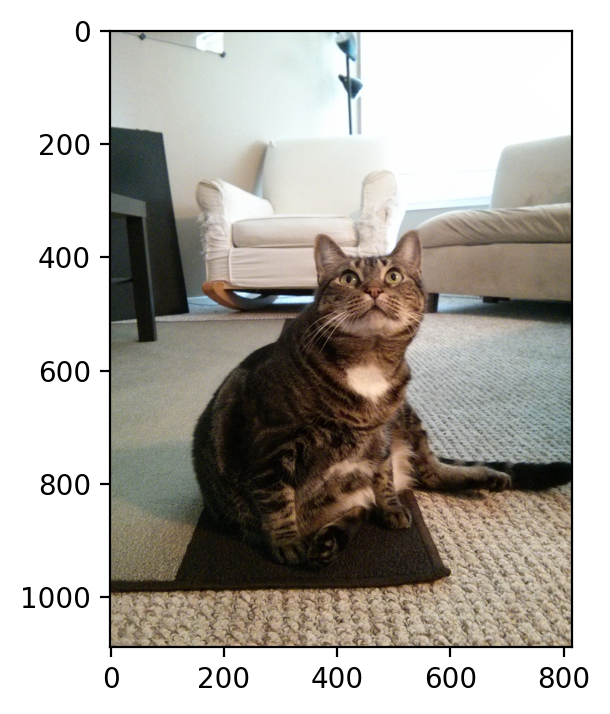

In [ ]:
# show our image using matplotlib
plt.imshow(image)

In [ ]:
# Displaying image using image.show
# It works in local displas like vscode but not on google colab
image.show()

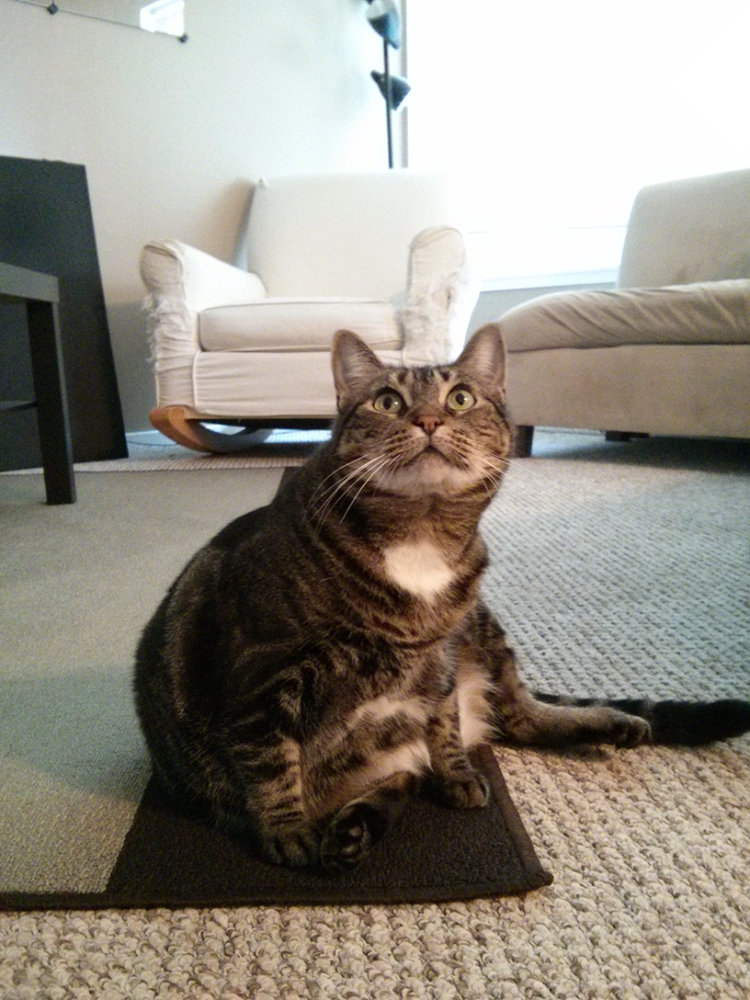

In [ ]:
# We use Ipython.display to display image from now onwards
display(image)

# Processing an Image

image.format: PNG
image.size: (816, 1088)
image.mode: RGB
image.format_description: Portable network graphics


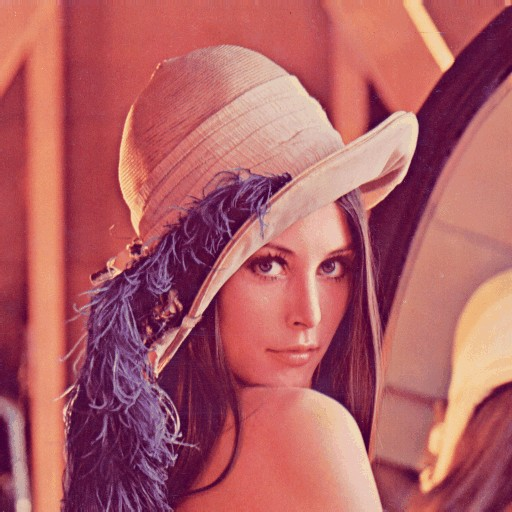

In [ ]:
img = Image.open('/content/drive/MyDrive/CS506/lena.jpg')
print(f'image.format: {image.format}')
print(f'image.size: {image.size}')  # (width, height)
print(f'image.mode: {image.mode}')
print(f'image.format_description: {image.format_description}')
display(img)

## Interpolation

### Image Resize with Image.resize()

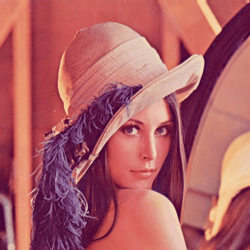

In [ ]:
# resize image
image_resized = img.resize((250, 250))  # (width, height)

# show resized image
display(image_resized)

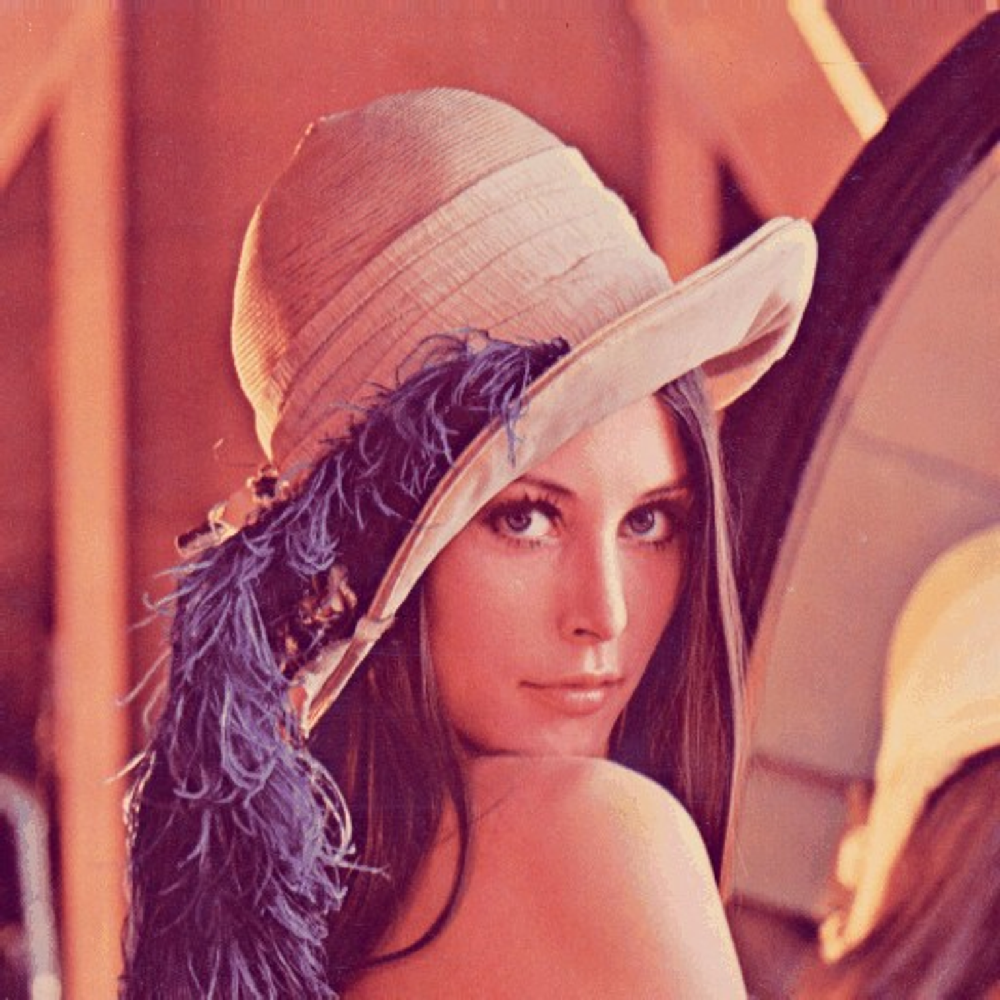

In [ ]:
# Magnifying image
magnification = 3
image_magnified = img.resize((img.width * magnification, img.height * magnification))
display(image_magnified)

### Resize with Thumbnail

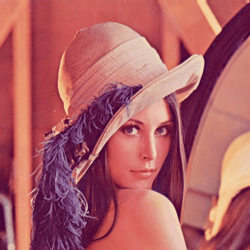

In [ ]:
# create a copy of our image as Image.thumbnail() MODIFIES THE IMAGE IN-PLACE
thumbnail = img.copy()

# resize the image with thumbnail
thumbnail.thumbnail((250,250))

# show the resized image
display(thumbnail)

### Resampling

In [ ]:
# create resample dictionary with names and Pillow resize methods
resample_dictionary = {'Nearest Neighbor': Image.NEAREST, 'Bilinear 2x2': Image.BILINEAR, 'Bicubic 4x4': Image.BICUBIC}

for name in resample_dictionary:

    print(name)

    # get resample_method by accessing the resample_dictionary with the key `name`
    resample_method = resample_dictionary[name]

    # call magic %timeit to time this line in our loop
    %timeit rotated_image = image_resized.rotate(-23, resample=resample_method, expand=True)  # negative angle is Clockwise


Nearest Neighbor
561 µs ± 75.7 µs per loop (mean ± std. dev. of 7 runs, 1000 loops each)
Bilinear 2x2
2.73 ms ± 114 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)
Bicubic 4x4
6.97 ms ± 76.2 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


# Image Rotation

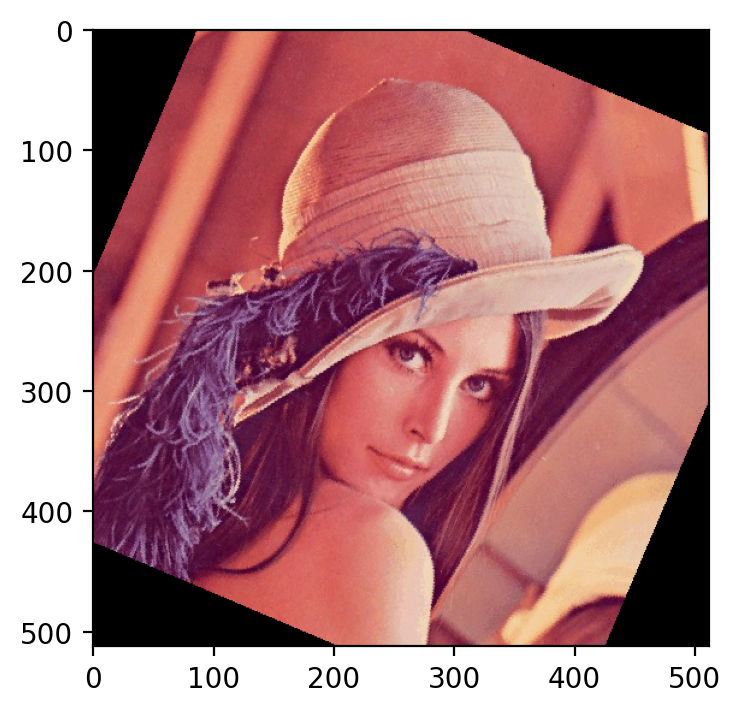

In [ ]:
# rotate image 23 degrees clockwise
# -ve values roates clockwise, +ve values rotates anti clockwise
rotated_image = img.rotate(-23)  # negative angle is Clockwise

# show rotated image
plt.imshow(rotated_image)

# Image Crop

Ddigital images are graphs of pixels channels and intensities in a 2D plane.

The graph's origin (0, 0) is the starting point of the image and the x-value increases with each pixel of width.

Even though we're technically graphing into negative y-values, the y-value increases with each pixel of height and extends BELOW the image.

We will use this coordinate system to crop our image.

https://pillow.readthedocs.io/en/stable/handbook/concepts.html#coordinate-system

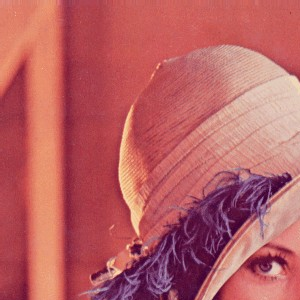

In [ ]:
# Pillow needs a box with upper-left (x, y) values and lower-right (x, y) values to crop an image
image_cropped = img.crop(box=(0, 0, 300, 300))  # start in upper-left and go right 300 pixels, down 300 pixels
display(image_cropped)

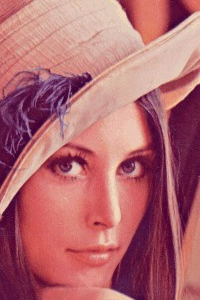

In [ ]:
image_cropped = img.crop(box=(200, 100, 400, 400))  # cropping specific pixels
display(image_cropped)

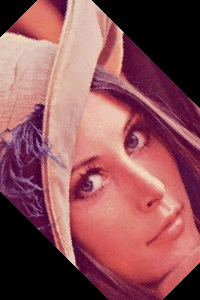

In [ ]:
image_cropped = img.crop((200, 100, 400, 400)).rotate(45)  # Cropping specific pixels and rotating
display(image_cropped)

In [ ]:
# print width & height of cropped image
print(f'width: {image_cropped.size[0]}')  # (width, height)
print(f'height: {image_cropped.size[1]}')

width: 200
height: 300


In [ ]:
# Save Image with quality
img.save('lenap95.jpg', quality=95)
img.save('lenap10.jpg', quality=10)

image.format: PNG
image.size: (816, 1088)
image.mode: RGB
image.format_description: Portable network graphics



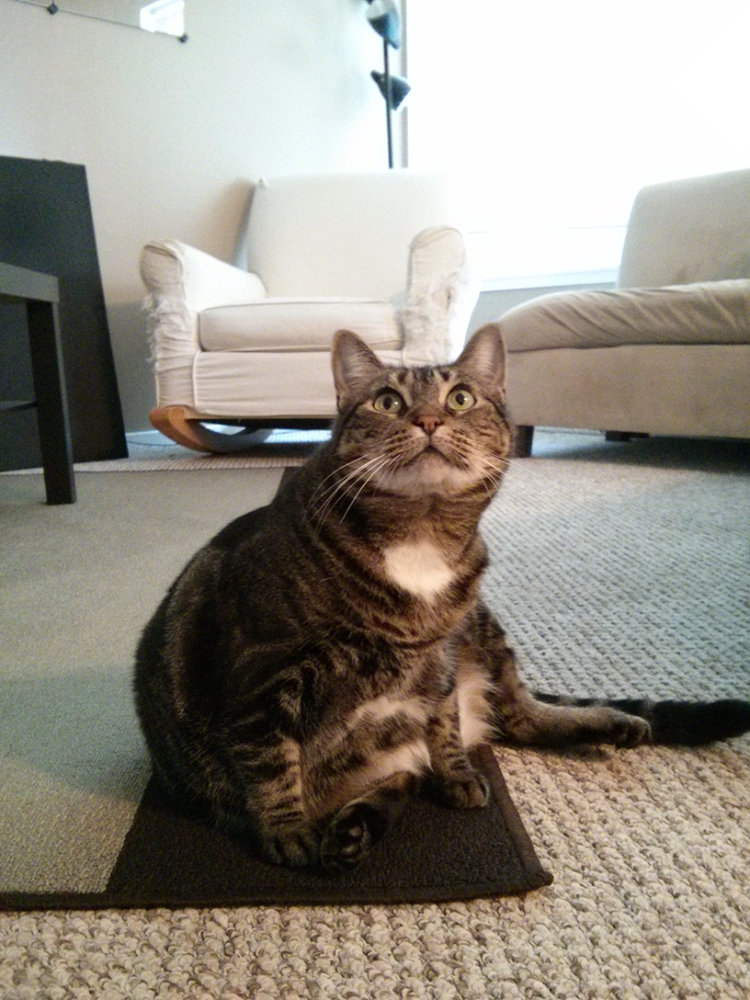

In [ ]:
# - Let's now crop and create a sub-image
#   And save to a different image format
im = Image.open('/content/drive/MyDrive/CS506/zophie.png')
# a quick way to see an image on the disk Image.open('zophie.png').show()

print(f'image.format: {image.format}')
print(f'image.size: {image.size}')  # (width, height)
print(f'image.mode: {image.mode}')
print(f'image.format_description: {image.format_description}')
print('')
display(im)

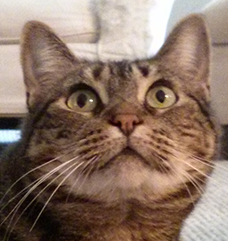

In [ ]:
# Let us choose box to crop
box = (340,338,568,579)
im_crop = im.crop(box)
# Verify the cropped image
display(im.crop(box))
# Save it to different formats
im_crop.save('cropped.png')
im_crop.save('cropped.ppm')
im_crop.save('cropped.bmp')
im_crop.save('cropped.gif')

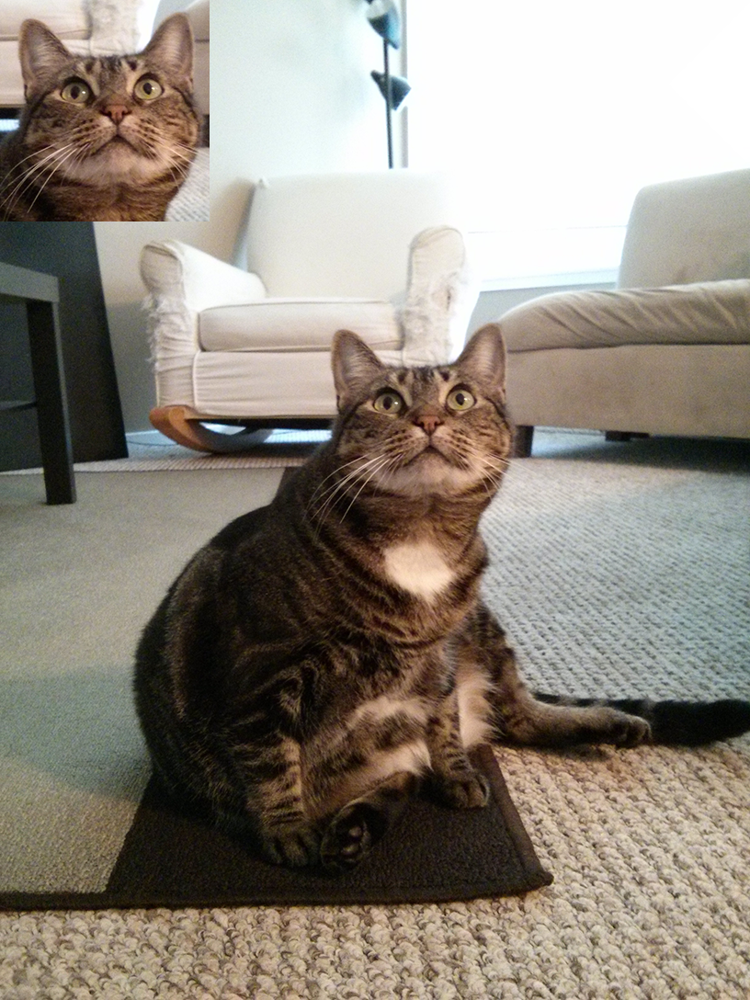

In [ ]:
# crop out and create a subimage, then paste into a certain location
catCopyIm = im.copy()
catFaceIm = catCopyIm.crop(box)
# target.paste
catCopyIm.paste(catFaceIm, (0, 0))
# at this point, catCopyIm has pasted face image
display(catCopyIm)

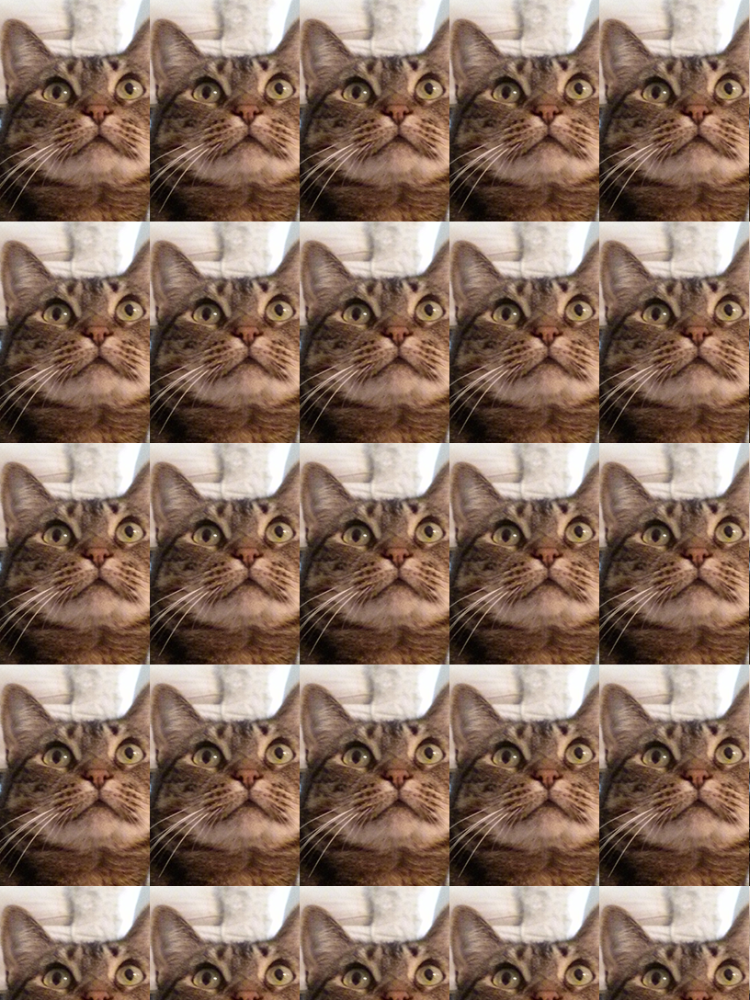

In [ ]:
# Making a tile image and rotation
catIm = Image.open('/content/drive/MyDrive/CS506/zophie.png')
box = (360,338,523,579) # 360 + (816/5=163) = 523
catFaceIm = catIm.crop(box)
catImWidth, catImHeight = catIm.size
catFaceImWidth, catFaceImHeight = catFaceIm.size
# Since this paste operation will modify the target image, need a copy.
catCopyImTile = catIm.copy()
i = 0
for x in range(0, catImWidth, catFaceImWidth):
    for y in range(0, catImHeight, catFaceImHeight):
        #print(x, y)
        catCopyImTile.paste(catFaceIm, (x, y))
        # catCopyImTile.paste(catFaceIm.rotate(10*i), (x, y))  # Pasting with rotation
        i += 1
catCopyImTile.show()
display(catCopyImTile)

# Understanding Color Modes

The 'mode' of an image in Pillow indicates the type and depth of the pixel data. Let's explore some common color modes:

**RGB**
* **Description:** Stands for Red, Green, and Blue. Each pixel's color is represented by the intensity of these three primary colors. This is the most common mode for color images.
* **Pixel Representation:** Each pixel is typically represented by 3 bytes (8 bits per channel), allowing for 256 shades of each color (resulting in 256 x 256 x 256 = 16,777,216 possible colors).


**RGBA**

* **Description:** Similar to RGB, but with an additional channel called Alpha. The Alpha channel represents the transparency of each pixel (0 for fully transparent, 255 for fully opaque).
* **Pixel Representation:** Typically 4 bytes per pixel (8 bits for Red, Green, Blue, and Alpha).



**L (Grayscale)**

* **Description:** Represents images in grayscale (black and white with shades of gray).
* **Pixel Representation:** Each pixel is represented by a single byte (8 bits), indicating its brightness level (0 for black, 255 for white).


In [ ]:
# Pillow offers the ImageColor.getcolor() that can provide RGBA tuple.
print(ImageColor.getcolor('cyan', 'RGBA'))  # This is case-insensitive

(0, 255, 255, 255)


In [ ]:
print(ImageColor.getcolor('black', 'RGBA'))

(0, 0, 0, 255)


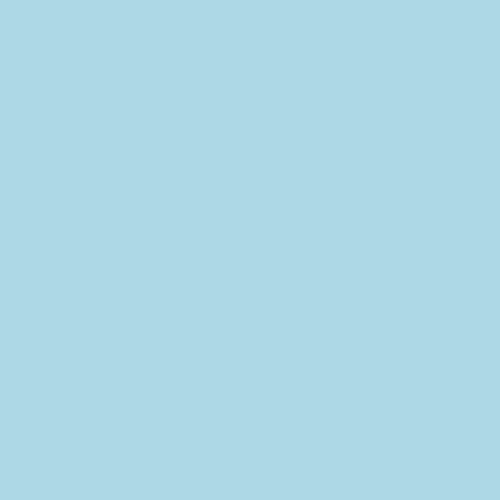

In [ ]:
# Image.new will create blank image. It takes 3 parameters.
# The string for the color mode (ex: 'RGBA', which sets the color mode to RGBA.)
# The size, as a two-integer tuple of the new image’s width and height.
# The background color that the image should start with, as a four-integer tuple of an RGBA value.
# Alternatively, Image.new() also supports just passing the string of the standard color name.
# Below command sets color mode to RGB with width and hight set to 500, color set to (173,216,230)
img = Image.new("RGB", (500, 500), (173, 216, 230))
#img.show()   # May not work in google colab as it opens new window.
display(img)

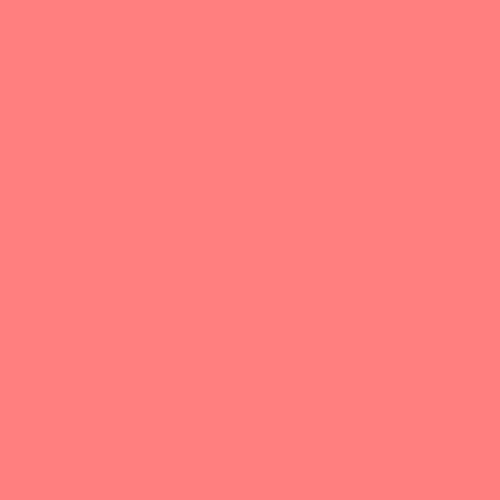

In [ ]:
# Let us create another image in RGBA mode
img = Image.new("RGBA", (500, 500), (255, 0, 0, 128))
#img.show()
display(img)

In [ ]:
# Save the image in different formats
img.save('a32.gif')
img.save('a32.png') # has the alpha information (opaque)
img.save('a32.jpg') # Fails due to RGBA format.

OSError: cannot write mode RGBA as JPEG

In [ ]:
# Convert the image from RGBA to RGB mode
img_jpg = img.convert("RGB") # We will loose opaque/transparency
img_jpg.save('a32.jpg')

## Working with Pixels

In [ ]:
img = Image.open('/content/drive/MyDrive/CS506/lena.jpg')
# reading a pixel data
print("The pixel values at location 0,0 are: ")
# getpixel gets (reads) the pixel values
img.getpixel((0,0))

The pixel values at location 0,0 are: 


(222, 132, 121)

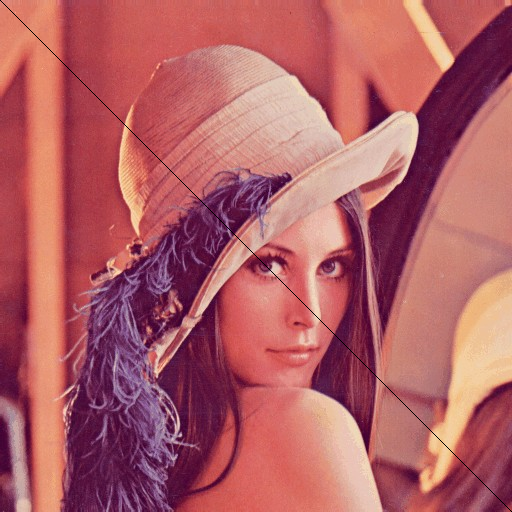

In [ ]:
# writing new pixel values in the image (write)
# putpixel() writes new pixel in the image
w, h = img.size
for x in range(h):
    img.putpixel((x, x), (0, 0, 0, 255))
display(img)

In [ ]:
img.getpixel((0,0))

(0, 0, 0)

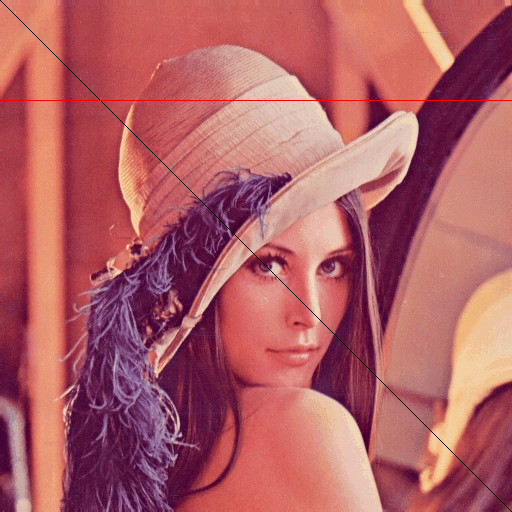

In [ ]:
# 2. using a PixelAccess obj to easy access []
imgpx = img.load() #Load image data based on sequence of data in a list [x,y]
imgpx[0, 0]
# you can also write the values to the image
for x in range(h):
    imgpx[x, 100] = (255, 0, 0)
img.show()
display(img)

## working with channels

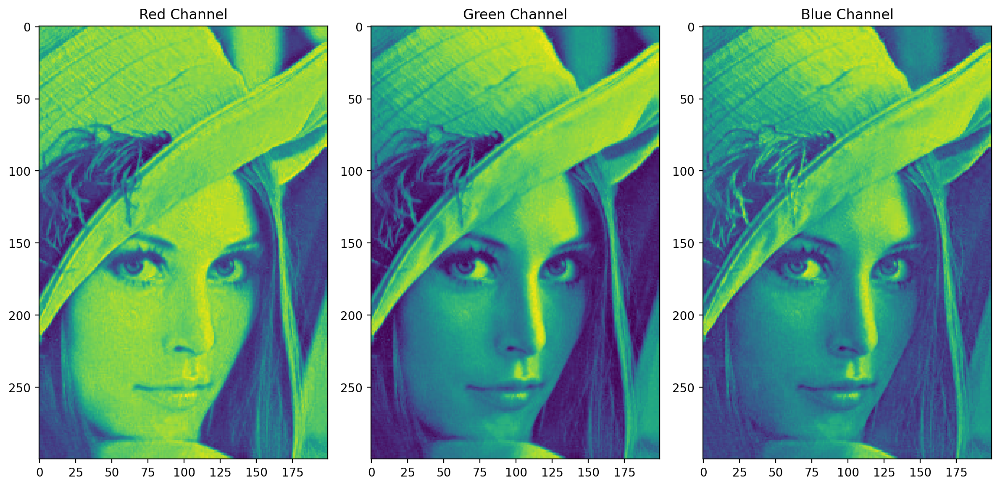

In [ ]:
# split into separate channels
red_channel, green_channel, blue_channel = image_cropped.split()

figure, (red, green, blue) = plt.subplots(ncols=3, figsize=(12, 6)) # figsize is (width, height) in inches

red.imshow(red_channel)
red.set_title("Red Channel")

green.imshow(green_channel)
green.set_title("Green Channel")

blue.imshow(blue_channel)
blue.set_title("Blue Channel")

# some MatPlotLib code that draws subplots close together while padding axes so they don't overlap
plt.tight_layout()

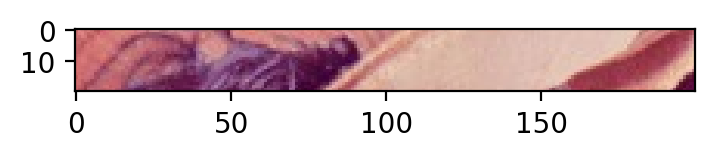

In [ ]:
# Let's crop our cropped image down to the color bar to better see our different color channels
color_bar = image_cropped.crop(box=(0, 70, 200, 90))

plt.imshow(color_bar)

## Convert to Grayscale

When converting from color to grayscale a choice is made on how much to weigh the intensity of each color band on each pixel. By default, Pillow uses the ITU-R 601-2 luma transform:

L(umninance) = Red * 299/1000 + Green * 587/1000 + Blue * 114/1000

Reference:
- https://pillow.readthedocs.io/en/stable/handbook/tutorial.html#color-transforms
- https://pillow.readthedocs.io/en/stable/reference/Image.html#PIL.Image.Image.convert


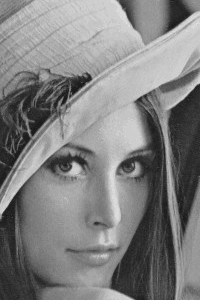

In [ ]:
# convert image to grayscale
image_grayscale = image_cropped.convert(mode='L')

display(image_grayscale)

**Dithering** is a technique used in image processing to create the illusion of intermediate shades of gray or color in an image with a limited color palette (like a bilevel black and white image). It works by strategically placing pixels of the available colors (in this case, black and white) in patterns. When viewed from a distance, these patterns trick the human eye into perceiving additional shades.

Think of it like pointillism in painting, where small dots of different colors are used to create the impression of a wider range of colors. In bilevel dithering, patterns of black and white pixels simulate gray tones.

The dither parameter in Pillow's convert() method controls whether or not dithering is applied during the color mode conversion. It accepts the following values (among others):

**Image.NONE:** This value explicitly tells Pillow not to apply any dithering during the conversion to the '1' (bilevel) mode. Each pixel in the original grayscale image will be directly mapped to either black or white based on a simple threshold (usually around the midpoint of the grayscale range, i.e., if the original pixel's brightness is above a certain value, it becomes white; otherwise, it becomes black). This can result in a stark, high-contrast black and white image with a loss of subtle gray tones.

**Image.FLOYDSTEINBERG:** This is a more sophisticated dithering algorithm. It distributes the quantization error (the difference between the original gray value and the nearest black or white value) to neighboring pixels. This often results in a more visually pleasing black and white image that better represents the original grayscale tones, although it can sometimes appear grainy due to the dither patterns.

**Image.ORDERED:** This uses a Bayer ordered dither matrix to determine the black and white pixels. It produces a more structured dither pattern compared to Floyd-Steinberg.

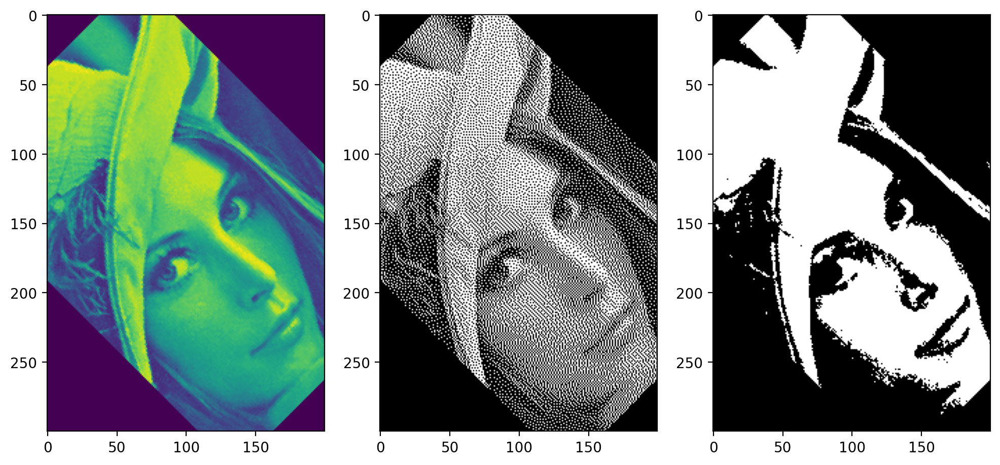

In [ ]:
# convert image to bitonal with Floyd-Steinberg dithering
image_bitonal_floyd_steinberg = image_grayscale.convert(mode='1')

# convert image to bitonal with no dithering
image_bitonal_no_dithering = image_grayscale.convert(mode='1', dither=Image.NONE)

figure, (img_gray, img_floyd, img_bitonal) = plt.subplots(ncols=3, figsize=(12, 6)) # figsize is (width, height) in inches


# show bitonal image with Floyd-Steinberg dithering
img_gray.imshow(image_grayscale)


# show bitonal image with Floyd-Steinberg dithering
img_floyd.imshow(image_bitonal_floyd_steinberg)


# show bitonal image with no dithering
img_bitonal.imshow(image_bitonal_no_dithering)


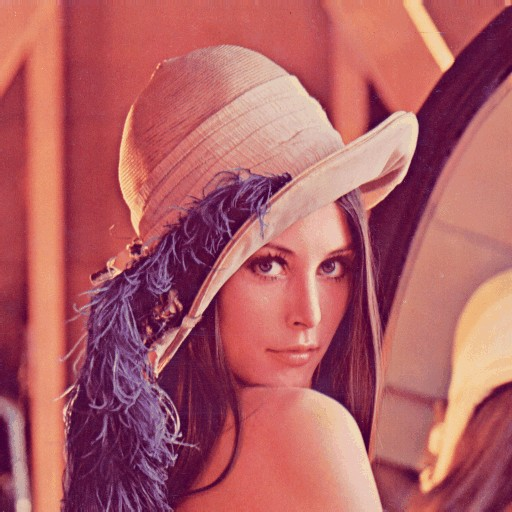

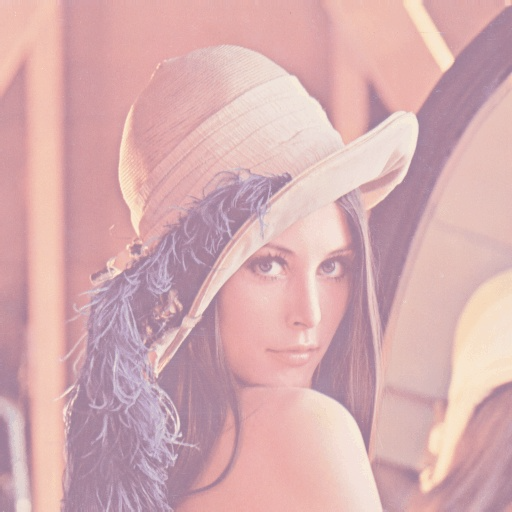

In [ ]:
# Adding a channel 'A' to RGB
# updating a jpg and adding opaque then save it into PNG format
img = Image.open('/content/drive/MyDrive/CS506/lena.jpg')
ima = img.copy()  # copying image to new object.
ima.putalpha(128)  # Adding alpha layer to existing image
ima.show()
display(img,ima)
ima.save('./lena_a.png')

# Composite Images

**Composite images** are digital images created by combining elements from two or more separate images. The goal is often to create a new image that appears to be a single, unified scene, even if the individual elements were originally photographed at different times, in different places, or even are entirely artificial (like computer-generated elements).

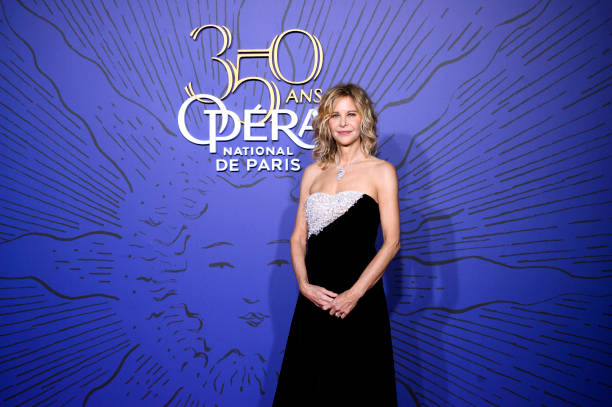

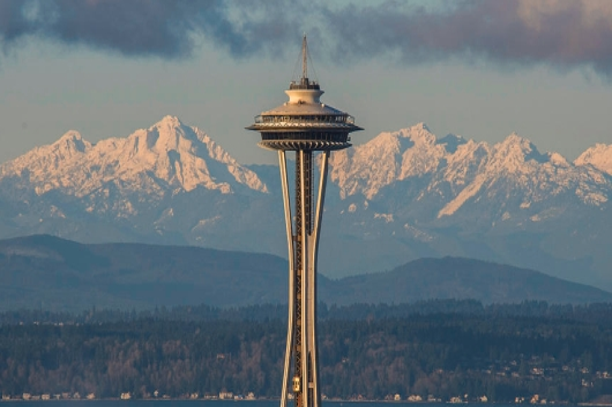

In [ ]:
# -- let's now composite 2 images with transparency control
# let's look at the composite method
# Image.composite(i1, i2, msk): Create composite image by blending images using a transparency mask.
# image 1 + image 2 + mask image(-> blending weight)
im1 = Image.open('/content/drive/MyDrive/CS506/megryan.jpg')                  # base image
im2 = Image.open('/content/drive/MyDrive/CS506/seattle.jpg').resize(im1.size) # new image
display(im1)
display(im2)

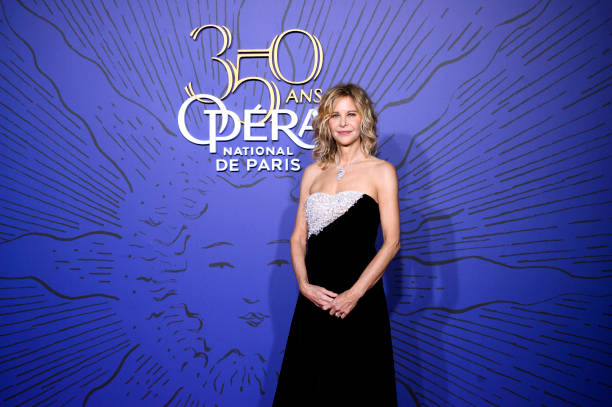

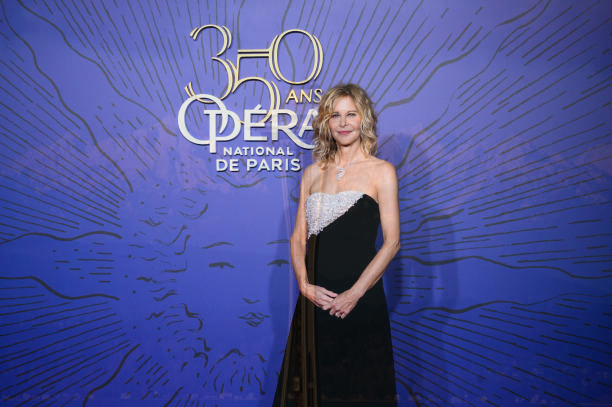

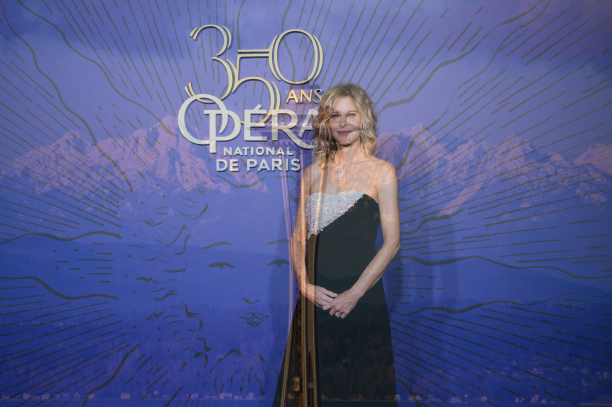

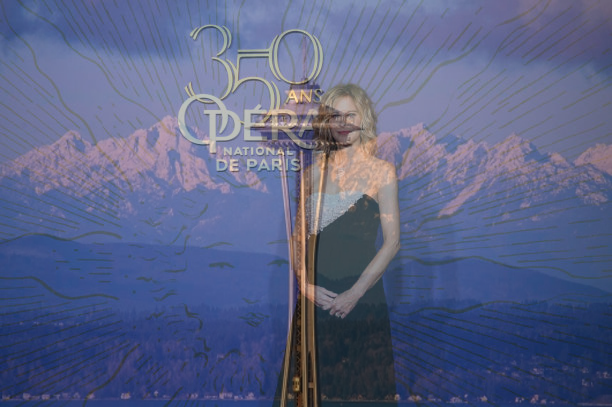

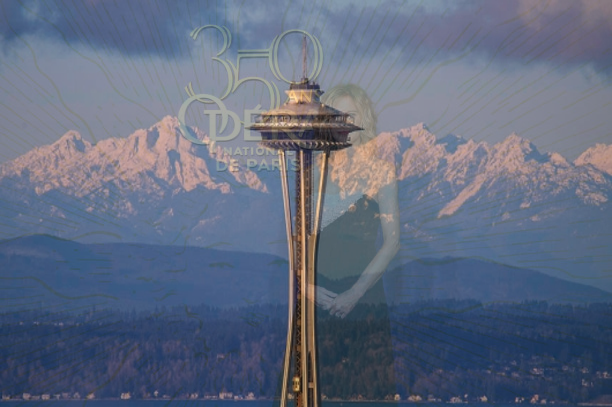

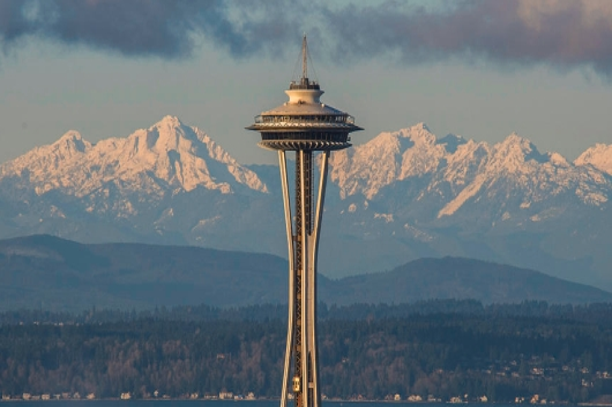

In [ ]:
import numpy
# creates a new image by interpolating between two input images, using a constant alpha.
# Image.blend(im1, im2, 0.5)
# out = image1 * (1.0 - alpha) + image2 * alpha

for i in numpy.arange(0, 1.2, 0.2): # Creating list of values from 0 to 1 with the distance of 0.2
    img = Image.blend(im1, im2, i)
    img.show()
    display(img)

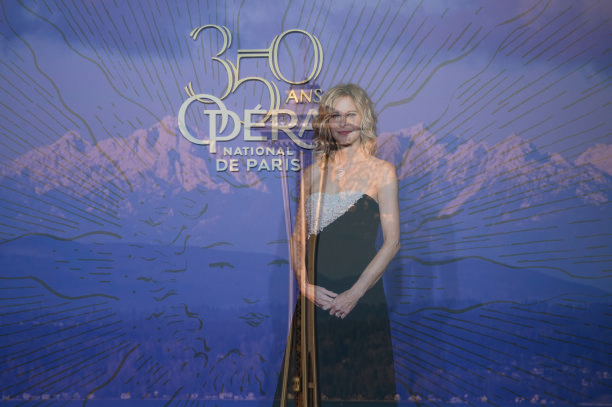

In [ ]:
# create a mask with grayscale image
mask = Image.new("L", im1.size, 128) # 'L'=8-bit pixels, black and white
imcomp = Image.composite(im1, im2, mask) # mask = weight
display(imcomp)

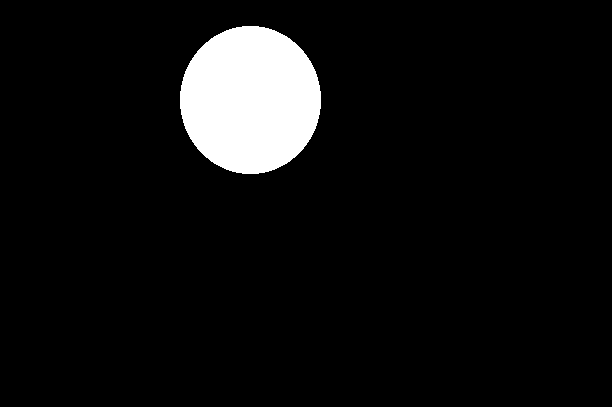

In [ ]:
# -- Let's add look at a shape
mask = Image.new("L", im1.size, 0)
# L: This mode stands for "luminance" and uses 8 bits per pixel, allowing for 256 shades of gray (from black to white).
# The ImageDraw module provides simple 2D graphics for Image objects.
# You can use this module to create new images, annotate or retouch
# existing images, and to generate graphics on the fly for web use.
# https://pillow.readthedocs.io/en/stable/reference/ImageDraw.html
draw = ImageDraw.Draw(mask)
draw.ellipse((180, 26, 320, 173), fill=255) # [(x0, y0, x1, y1]
mask.show() # show the mask image
display(mask)

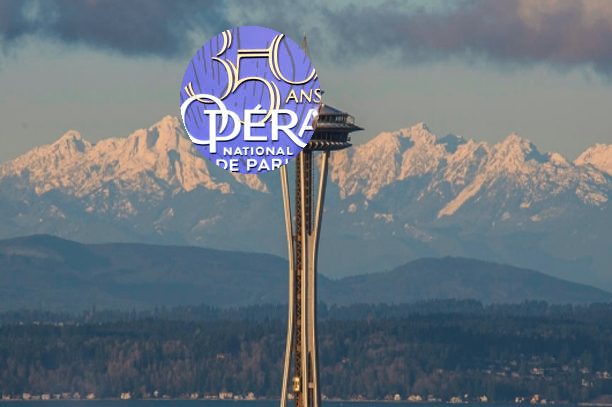

In [ ]:
# composite thru mask image (weight factor per pixel)
im = Image.composite(im1, im2, mask) # im = im1 * mask + im2
im.show()
display(im)

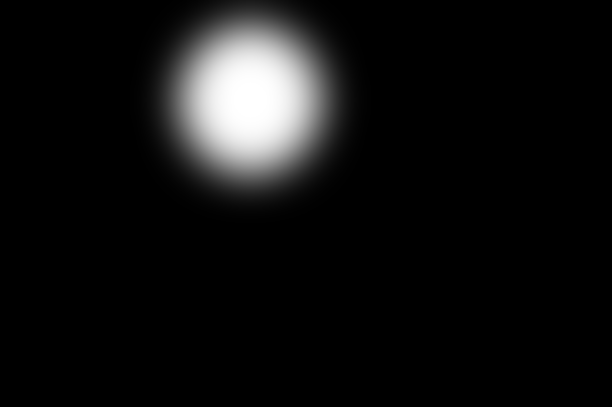

In [ ]:
# In order to make the border smooth, we can use some of the ImageFilter module
mask_blur = mask.filter(ImageFilter.GaussianBlur(20))
mask_blur.show()
display(mask_blur)

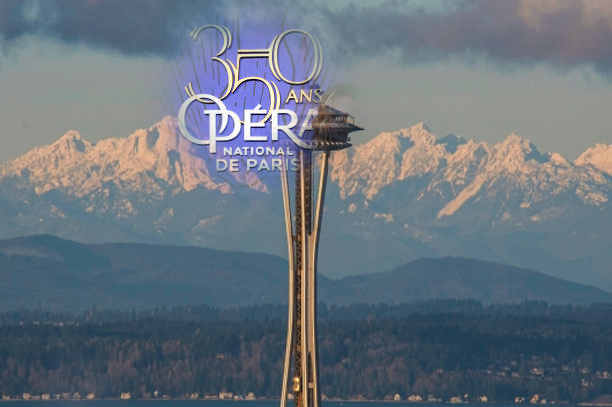

In [ ]:
im = Image.composite(im1, im2, mask_blur)
display(im)

# Animation effects

In [ ]:
def create_image_with_ball(width, height, ball_x, ball_y, ball_size):
    # create a white background
    img = Image.new('RGB', (width, height), (255, 255, 255))
    draw = ImageDraw.Draw(img)
    # draw.ellipse takes a 4-tuple (x0, y0, x1, y1) where (x0, y0) is the top-left bound of the box
    # and (x1, y1) is the lower-right bound of the box.
    draw.ellipse((ball_x, ball_y, ball_x + ball_size, ball_y + ball_size), fill='red')
    return img

# Create the frames
frames = []
x, y = 0, 0
for i in range(20):
    new_frame = create_image_with_ball(400, 400, x, y, 80)
    # new_frame = create_image_with_ball(400, 400, x, y, 400/(i+1)) # 3D effect going away from me trajectory
    frames.append(new_frame)
    x += 20
    y += 20

# Save into a GIF file that loops forever
frames[0].save('moving.gif', format='GIF', append_images=frames[1:], save_all=True, duration=100)

In [ ]:
# Let's make an animated gif file.
# Imagine that you have a field of view from the camera (200 X 200), and it scans thru
# a diagonal path, and display them on as an animated gif.
catIm = Image.open('/content/drive/MyDrive/CS506/zophie.png')
box = (0, 0, 200, 200)

# Create the frames
frames = []
x, y = 0, 0
for i in range(0, catIm.width-200, 10):
    new_frame = catIm.crop(box)
    frames.append(new_frame)
    box = tuple(x + 10 for x in box)
# Save into a GIF file that loops forever
frames[0].save('moving_cat.gif', format='GIF', append_images=frames[1:], save_all=True, duration=100)

**Rotating Cat **


1.   open an image
2.   crop the cat's face using box tuple (x0, y0, x1, y1) with crop() then store it into another Image object
3.   create the frames starting with empty frame
4.    rotate 360 by 1 degree using range() followed by (1) rotate() and (2) append the frames
5.    save the frames using format=GIF, append_images, save_all, duration to control the frame rate

In [ ]:
# Let's make an animated gif file.
# Imagine that you have a field of view from the camera (200 X 200), and it scans thru
# a diagonal path, and display them on as an animated gif.
catIm = Image.open('/content/drive/MyDrive/CS506/zophie.png')
box = (360,338,523,579) # 360 + (816/5=163) = 523
catFaceIm = catIm.crop(box)

# Create the frames
frames = []
for i in range(0, 360):
    new_frame = catFaceIm.rotate(i)
    frames.append(new_frame)

# Save into a GIF file that loops forever
frames[0].save('rotating_cat.gif', format='GIF', append_images=frames[1:], save_all=True, duration=10)

# Mathematical shapes

References:
- https://pillow.readthedocs.io/en/latest/reference/ImageDraw.html

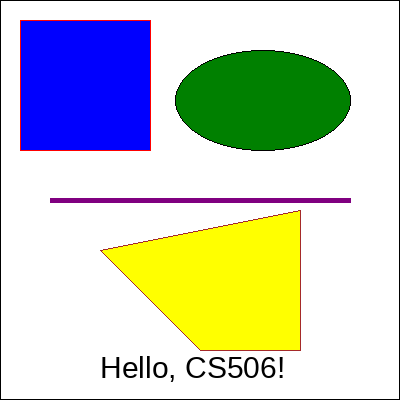

In [ ]:
# code to demostrate mathematical objects using pillow module
from PIL import Image, ImageDraw, ImageFont

# Create a new blank image
img = Image.new('RGB', (400, 400), 'white')
draw = ImageDraw.Draw(img)
draw.line([(0, 0), (399, 0), (399, 399), (0, 399), (0, 0)], fill='black')
# Draw shapes
draw.rectangle((20, 20, 150, 150), fill='blue', outline='red')  # Rectangle
draw.ellipse((175, 50, 350, 150), fill='green', outline='black')  # Ellipse/Circle
draw.line((50, 200, 350, 200), fill='purple', width=5)  # Line
draw.polygon([(100, 250), (200, 350), (300, 350), (300, 210)], fill='yellow', outline='brown')  # Polygon

# Add text
font = ImageFont.truetype('/usr/share/fonts/truetype/liberation/LiberationSans-Regular.ttf', 30)  # Choose a font available in Colab
draw.text((100, 350), "Hello, CS506!", font=font, fill='black')

# Display the image in Colab
display(img)

# Save the image
img.save('mathematical_objects.png')